In [1]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt # plotting
import numpy as np # linear algebra
import os # accessing directory structure
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import re 
import os
import string
from sklearn.feature_extraction.text import CountVectorizer
from keras.preprocessing.sequence import pad_sequences
from sklearn.preprocessing import LabelEncoder
from wordcloud import WordCloud
from bidi.algorithm import get_display
import arabic_reshaper 
#from ar_wordcloud import ArabicWordCloud

Loading the data
------
Processing the dataset using : tf.keras.preprocessing.text_dataset_from_directory

In [2]:
def raw_date(directory) :
    raw_data = tf.keras.preprocessing.text_dataset_from_directory(
    directory,
    # "inferred" : the labels are generated from the directory structure
    labels = "inferred",
    # "int": the labels are encoded as integers
    label_mode = "int",
    # Maximum size of a text string.
    max_length = None,
    # Whether to shuffle the data. If False, sorts the data in alphanumeric order.
    shuffle=True,
    # Optional random seed for shuffling and transformations. 
    seed=10,
    # Optional float between 0 and 1, fraction of data to reserve for validation
    validation_split=None,
    # Only used if validation_split is set, mahich set alors sotit
    subset=None)
    return raw_data

In [3]:
raw_data = raw_date('./Khaleej')
raw_data

Found 45500 files belonging to 7 classes.


<BatchDataset element_spec=(TensorSpec(shape=(None,), dtype=tf.string, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

Have a look at our classes

In [4]:
print("Classes names:\n",raw_data.class_names)

Classes names:
 ['Culture', 'Finance', 'Medical', 'Politics', 'Religion', 'Sports', 'Tech']


Forming the text and lable lists from the dataset

In [5]:
def convertToList(Raw_data):
    text=[]
    label=[]
    # for each folder(category), we will loop over its text files
    for raw_data in Raw_data :
        # for each text file in the folder, append it to text list and append its category to label list
        for text_batch, label_batch in raw_data:
            for i in range(len(text_batch)):
                s=text_batch.numpy()[i].decode("utf-8") 
                text.append(s)
                label.append(raw_data.class_names[label_batch.numpy()[i]])
    return text,label        

In [6]:
text, label = convertToList([raw_data])

In [7]:
len(text)

45500

In [8]:
len(label)

45500

In [9]:
type(text)

list

Exploring some texts and their lables

In [10]:
print(label[1])
print(text[1])

Tech
دبي - حمدي سعد:تعتبر التطورات والمبادرات التي تقودها دبي في مجال المدن الذكية رائدةً على مستوى العالم، فيما تخطط "إنتل"، أكبر منتج للرقائق الإلكترونية في العالم، للمساهمة في هذه المشاريع المميزة، حيث تعد المدن الذكية من الاتجاهات الرئيسية لتطور المدن العالمية، بحسب نورس صاوصو، المدير الإقليمي في منطقة الخليج، قطاع التّجزئة في "إنتل" .\par قال صاوصو ل"الخليج": لعل من أهم جوانب المدن الذكية موضوع إدارة الموارد، سواءً المياه أو الطاقة أو النقل والمواصلات، حيث يتم تسخير التقنية لتسهيل حياة الناس من حيث الحصول على الخدمات والمعيشة وعمل ما يريدونه، بشكل عام، ولا يقتصر ذلك على استخدام التقنية فحسب، بل يتعلق باستخدام أحدث الابتكارات لتسهيل الحياة وتحسين كفاءة استخدام الطاقة وخفض التكاليف والازدحام المروري .وقال: تسعى إنتل، إلى توفير المكونات التقنية اللازمة لمواجهة التحديات ،كما ستلعب مفاهيم إنترنت الأشياء دوراً مهماً ليس فقط في مباني المستقبل، بل في جميع عناصر المدن التي تزداد ترابطاً وتداخلاً . 26 مليار جهاز وأوضح صاوصو أن سوق تقنية المعلومات تتطور نحو اتجاهات جديدة وبحلول العام ،2020 س

In [11]:
print(label[6])
print(text[6])

Finance
أبوظبي علي أسعد: سيطرت أجواء الحذر والترقب على أسواق المال في الدولة خلال جلسة أمس، وهو ما أضعف حركة التداول التي لم تسعف الكثير من المستثمرين في الخروج خوفا من الأسوأ في اتجاه حركة الأسهم المحلية وأسعار النفط خلال جلسة اليوم الاثنين خاصة إذا تراجعت الأسواق الآسيوية وتحديدا الصينية. أدت هذه المخاوف إلى تراجع القيمة السوقية للأسواق بمقدار 1.24 مليار درهم لتصل إلى 666.83 مليار درهم مع إغلاق مؤشر سوق الإمارات على انخفاض 0.19 % عند 4112.91 نقطة متأثراً بالضغوط على اسهم شركات العقار والسلع الاستهلاكية والتأمين والاستثمار والصناعة والخدمات والبنوك التي تراجعت مؤشراتها القطاعية بنسب متفاوتة أكثرها تراجعا مؤشر شركات السلع الاستهلاكية 1.788%، تلاه مؤشر شركات العقار الذي هبط بنسبة 0.995%. وخففت المؤشرات القطاعية لشركات قطاعي الاتصالات والطاقة من تراجع الأسواق المحلية، حيث أغلقت هذه المؤشرات على ارتفاعات نسب 0.0.183%، و1.144% كل منهما على التوالي. وتباين أداء سوقي أبوظبي ودبي خلال جلسة أمس، ففي الوقت الذي اغلق فيه مؤشر سوق أبوظبي للأوراق المالية على ارتفاع خجل بنسبة 0.16% عند مستوى4141.49

Creating data frame from text and lable lists using pandas
----

In [12]:
data =pd.DataFrame({"text":text,"label":label}) 

In [13]:
data

,text,label
0,كشف جيسوس نافاس جناح مانشستر سيتي الجديد عن تق...,Sports
1,دبي - حمدي سعد:تعتبر التطورات والمبادرات التي ...,Tech
2,تعاقد نادي سسكا موسكو الروسي مع المهاجم الدولي...,Sports
3,أشاد إدجاردو باوزا، مدرب الأرجنتين بنجم المنتخ...,Sports
4,توفي، أمس، البائع المغربي المتجوّل نور الدين ع...,Politics
...,...,...
45495,يعد هاتف HTC One X أول هاتف ذكي من شركة اتش تي...,Tech
45496,ما يجب ان نفهمه من محاسبة الشيخ الأكبر لنفسه أ...,Religion
45497,أعلن نادي ميلان الإيطالي، رسمياً، تجديد عقد لا...,Sports
45498,دبي: «الخليج» و«وام» أكد سمو الشيخ حمدان بن مح...,Tech


In [14]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45500 entries, 0 to 45499
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   text    45500 non-null  object
 1   label   45500 non-null  object
dtypes: object(2)
memory usage: 711.1+ KB


In [15]:
data.describe()

,text,label
count,45500,45500
unique,45485,7
top,إعداد: محمد صالح القرق دخل على رسول الله- صلى ...,Sports
freq,3,6500


In [16]:
data.shape

(45500, 2)

Dealing with null values
-----

In [17]:
data.isnull().sum()

text     0
label    0
dtype: int64

Dealing with duplicates
--------

In [18]:
data.duplicated().sum()

15

Drop duplicates

In [19]:
data.drop_duplicates(inplace=True)
data.duplicated().sum()

0

In [20]:
len(data)

45485

In [21]:
data

,text,label
0,كشف جيسوس نافاس جناح مانشستر سيتي الجديد عن تق...,Sports
1,دبي - حمدي سعد:تعتبر التطورات والمبادرات التي ...,Tech
2,تعاقد نادي سسكا موسكو الروسي مع المهاجم الدولي...,Sports
3,أشاد إدجاردو باوزا، مدرب الأرجنتين بنجم المنتخ...,Sports
4,توفي، أمس، البائع المغربي المتجوّل نور الدين ع...,Politics
...,...,...
45495,يعد هاتف HTC One X أول هاتف ذكي من شركة اتش تي...,Tech
45496,ما يجب ان نفهمه من محاسبة الشيخ الأكبر لنفسه أ...,Religion
45497,أعلن نادي ميلان الإيطالي، رسمياً، تجديد عقد لا...,Sports
45498,دبي: «الخليج» و«وام» أكد سمو الشيخ حمدان بن مح...,Tech


In [22]:
data.describe()

,text,label
count,45485,45485
unique,45485,7
top,كشف جيسوس نافاس جناح مانشستر سيتي الجديد عن تق...,Tech
freq,1,6500


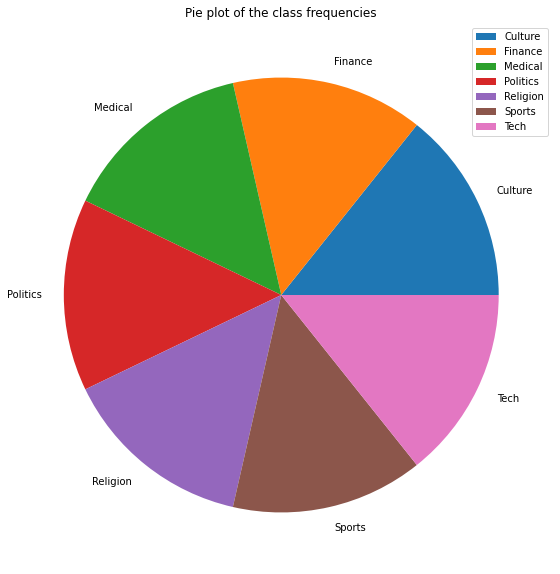

In [23]:
unique, counts = np.unique(label, return_counts=True)
plt.figure("classe Pie", figsize=(10, 10))
plt.title("Pie plot of the class frequencies")
plt.pie(counts, labels=raw_data.class_names)
plt.legend(unique)
plt.show();

In [24]:
def generateWordCloud(text,label):
    plt.figure(figsize=(15,8))
    
    wc = WordCloud(font_path='../input/arial-font/arial.ttf',max_words = 100).generate(get_display(arabic_reshaper.reshape(text)))
    path = "{}.png".format(label)
    wc.to_file(path)
    
    plt.imshow(wc)
    plt.axis('off')

In [144]:
def concatenate(data, label):
    text = ""
    for i in data.index:
        if(data["label"][i] == label):
            text += data["text"][i] + " "
        #print(df['Name'][ind], df['Stream'][ind])
    return text    

In [26]:
Tech = concatenate(data, "Tech")
Tech

'دبي - حمدي سعد:تعتبر التطورات والمبادرات التي تقودها دبي في مجال المدن الذكية رائدةً على مستوى العالم، فيما تخطط "إنتل"، أكبر منتج للرقائق الإلكترونية في العالم، للمساهمة في هذه المشاريع المميزة، حيث تعد المدن الذكية من الاتجاهات الرئيسية لتطور المدن العالمية، بحسب نورس صاوصو، المدير الإقليمي في منطقة الخليج، قطاع التّجزئة في "إنتل" .\\par قال صاوصو ل"الخليج": لعل من أهم جوانب المدن الذكية موضوع إدارة الموارد، سواءً المياه أو الطاقة أو النقل والمواصلات، حيث يتم تسخير التقنية لتسهيل حياة الناس من حيث الحصول على الخدمات والمعيشة وعمل ما يريدونه، بشكل عام، ولا يقتصر ذلك على استخدام التقنية فحسب، بل يتعلق باستخدام أحدث الابتكارات لتسهيل الحياة وتحسين كفاءة استخدام الطاقة وخفض التكاليف والازدحام المروري .وقال: تسعى إنتل، إلى توفير المكونات التقنية اللازمة لمواجهة التحديات ،كما ستلعب مفاهيم إنترنت الأشياء دوراً مهماً ليس فقط في مباني المستقبل، بل في جميع عناصر المدن التي تزداد ترابطاً وتداخلاً . 26 مليار جهاز وأوضح صاوصو أن سوق تقنية المعلومات تتطور نحو اتجاهات جديدة وبحلول العام ،2020 سيتج

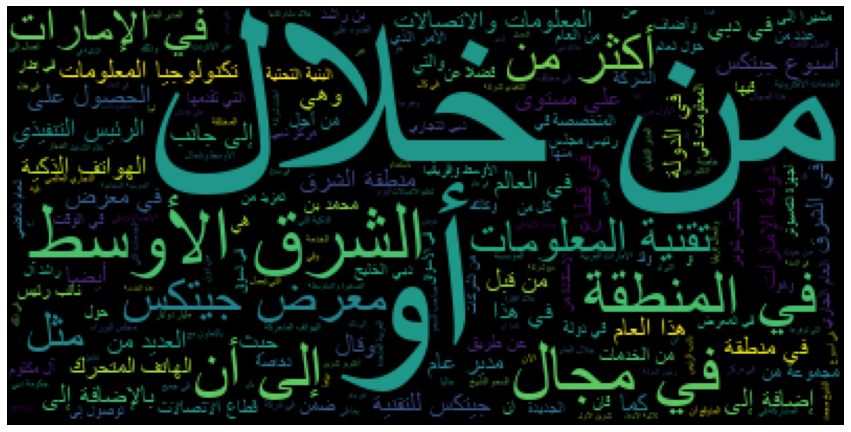

In [27]:
generateWordCloud(Tech)

AS we can see, we have a lot of stop words that need to be deleted,
so let's apply some cleaning techniques, so that we can visualize the data well

Cleaning
---------

1-Remove Stop words
-----

In [109]:
# Arabic stop words with nltk
stop_words= pd.read_excel(r'I:\Semester 10\NLP\stop_words.xlsx')
stop_words=stop_words.get('stop words')
stop_words =list(stop_words)+ list(nltk.corpus.stopwords.words("arabic"))
stop_words.append('بعد')
stop_words.append('خلال')
stop_words.append('الرغم')
stop_words.append('بها')
stop_words.append('به')
stop_words.append('بينما')
stop_words.append('ايضا')
stop_words.append('امس')
stop_words.append('غدا')
stop_words.append('اليوم')
stop_words.append('عام')
stop_words.append('سنة')
#stop_words.append('حتى')
stop_words.append('ذلك')
print(len(stop_words))

2267


1.1 Normalize arabic letters of the stop words
-------

In [110]:
def normalize_letters(text):
    text = re.sub("[إأآا]", "ا", text)
    text = re.sub("ى", "ي", text)
    #text = re.sub("ؤ", "ء", text)
    #text = re.sub("ئ", "ء", text)
    text = re.sub("ة", "ه", text)
    return text;

In [115]:
for word in stop_words :
    word = normalize_letters(str(word))

In [117]:
normalize_letters("حتى تحترق النجوم")

'حتي تحترق النجوم'

1.2 Normalize arabic letters of the data itself
------

In [118]:
data['text'] = data['text'].apply(lambda x: normalize_letters(x))

In [119]:
data["text"][2]

'تعاقد نادي سسكا موسكو الروسي مع المهاجم الدولي النيجيري احمد موسي لمده خمسه اعوام من نادي فنلو الهولندي، بحسب ما اعلن الاول .وخاض موسي (19 عاماً) 13 مباراه مع المنتخب النيجيري سجل فيها هدفا واحدا، وانضم الي معسكر سسكا موسكو في منتجع كامبوامور الاسباني حيث يستعد الفريق لمواجهه ريال مدريد الاسباني في الدور الثاني من دوري ابطال اوروبا لكره القدم في 21 فبراير المقبل .وقال موسي: انا سعيد للانتقال، سيمنحني سسكا فرصه اللعب في اوروبا مع لاعبين مميزين .ولم يتم الكشف عن قيمه الصفقه، الا ان شبكه سوبر سبورت الجنوب افريقيه كشفت ان اللاعب سيكلف النادي الروسي 10 ملايين يورو .'

1.3 Remove stop words 
-------

In [120]:
def remove_stopwords(text):
    return " ".join([word for word in str(text).split() if word not in stop_words])

In [121]:
data['text'] = data['text'].apply(lambda x: remove_stopwords(x))

In [122]:
data.head()

,text,label
0,كشف جيسوس نافاس جناح مانشستر سيتي الجديد تقدم ...,Sports
1,دبي - حمدي سعد:تعتبر التطورات والمبادرات تقوده...,Tech
2,تعاقد نادي سسكا موسكو الروسي المهاجم الدولي ال...,Sports
3,اشاد ادجاردو باوزا، مدرب الارجنتين بنجم المنتخ...,Sports
4,توفي، امس، البائع المغربي المتجوّل نور الدين ع...,Politics


In [123]:
data["text"][1]

'دبي - حمدي سعد:تعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائدهً مستوي العالم، تخطط "انتل"، اكبر منتج للرقائق الالكترونيه العالم، للمساهمه المشاريع المميزه، تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه، بحسب نورس صاوصو، المدير الاقليمي منطقه الخليج، قطاع التّجزئه "انتل" .\\par صاوصو ل"الخليج": اهم جوانب المدن الذكيه موضوع اداره الموارد، سواءً المياه الطاقه النقل والمواصلات، يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه، عام، يقتصر استخدام التقنيه فحسب، يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري .وقال: تسعي انتل، توفير المكونات التقنيه اللازمه لمواجهه التحديات ،كما ستلعب مفاهيم انترنت الاشياء دوراً مهماً مباني المستقبل، عناصر المدن تزداد ترابطاً وتداخلاً . 26 جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام ،2020 سيتجاوز ،بحسب "غارتنر"، حجم قاعده الاجهزه المتصله بانترنت الاشياء 26 جهاز مستوي العالم، تعد التقنيات الملبوسه خيالاً مستقبلياً، ففي الواقع، تتوقع وكا

2-Remove English letters
-------

In [124]:
def remove_english_letters(text):
    return re.sub("[a-zA-Z]", "", text)

In [125]:
data['text'] = data['text'].apply(lambda x: remove_english_letters(x))

In [126]:
data["text"][1]

'دبي - حمدي سعد:تعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائدهً مستوي العالم، تخطط "انتل"، اكبر منتج للرقائق الالكترونيه العالم، للمساهمه المشاريع المميزه، تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه، بحسب نورس صاوصو، المدير الاقليمي منطقه الخليج، قطاع التّجزئه "انتل" .\\ صاوصو ل"الخليج": اهم جوانب المدن الذكيه موضوع اداره الموارد، سواءً المياه الطاقه النقل والمواصلات، يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه، عام، يقتصر استخدام التقنيه فحسب، يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري .وقال: تسعي انتل، توفير المكونات التقنيه اللازمه لمواجهه التحديات ،كما ستلعب مفاهيم انترنت الاشياء دوراً مهماً مباني المستقبل، عناصر المدن تزداد ترابطاً وتداخلاً . 26 جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام ،2020 سيتجاوز ،بحسب "غارتنر"، حجم قاعده الاجهزه المتصله بانترنت الاشياء 26 جهاز مستوي العالم، تعد التقنيات الملبوسه خيالاً مستقبلياً، ففي الواقع، تتوقع وكاله 

In [127]:
def remove_twitter_meta(text):
    return re.sub("[#@_]", "", text)

In [128]:
data['text'] = data['text'].apply(lambda x: remove_twitter_meta(x))

In [129]:
data["text"][1]

'دبي - حمدي سعد:تعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائدهً مستوي العالم، تخطط "انتل"، اكبر منتج للرقائق الالكترونيه العالم، للمساهمه المشاريع المميزه، تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه، بحسب نورس صاوصو، المدير الاقليمي منطقه الخليج، قطاع التّجزئه "انتل" .\\ صاوصو ل"الخليج": اهم جوانب المدن الذكيه موضوع اداره الموارد، سواءً المياه الطاقه النقل والمواصلات، يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه، عام، يقتصر استخدام التقنيه فحسب، يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري .وقال: تسعي انتل، توفير المكونات التقنيه اللازمه لمواجهه التحديات ،كما ستلعب مفاهيم انترنت الاشياء دوراً مهماً مباني المستقبل، عناصر المدن تزداد ترابطاً وتداخلاً . 26 جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام ،2020 سيتجاوز ،بحسب "غارتنر"، حجم قاعده الاجهزه المتصله بانترنت الاشياء 26 جهاز مستوي العالم، تعد التقنيات الملبوسه خيالاً مستقبلياً، ففي الواقع، تتوقع وكاله 

3-Remove Punctuations
--------

In [130]:
punctuations = '''`÷×؛<>_()*&^%][ـ،/:"؟،.,'{}~¦+|!”…“–ـ''' + string.punctuation

In [131]:
def remove_punctuations(text):
    translator = str.maketrans('', '', punctuations)
    text = text.translate(translator)
    return text

In [132]:
data['text'] = data['text'].apply(lambda x: remove_punctuations(x))

In [133]:
data["text"][1]

'دبي  حمدي سعدتعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائدهً مستوي العالم تخطط انتل اكبر منتج للرقائق الالكترونيه العالم للمساهمه المشاريع المميزه تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه بحسب نورس صاوصو المدير الاقليمي منطقه الخليج قطاع التّجزئه انتل  صاوصو لالخليج اهم جوانب المدن الذكيه موضوع اداره الموارد سواءً المياه الطاقه النقل والمواصلات يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه عام يقتصر استخدام التقنيه فحسب يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري وقال تسعي انتل توفير المكونات التقنيه اللازمه لمواجهه التحديات كما ستلعب مفاهيم انترنت الاشياء دوراً مهماً مباني المستقبل عناصر المدن تزداد ترابطاً وتداخلاً  26 جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام 2020 سيتجاوز بحسب غارتنر حجم قاعده الاجهزه المتصله بانترنت الاشياء 26 جهاز مستوي العالم تعد التقنيات الملبوسه خيالاً مستقبلياً ففي الواقع تتوقع وكاله جونيبر تبلغ المبيعات العالميه للاجهزه 

4-Remove digits
--------

In [134]:
def remove_digits(text):
    return re.sub("[0-9]", "", text)

In [135]:
data['text'] = data['text'].apply(lambda x: remove_digits(x))

In [136]:
data["text"][1]

'دبي  حمدي سعدتعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائدهً مستوي العالم تخطط انتل اكبر منتج للرقائق الالكترونيه العالم للمساهمه المشاريع المميزه تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه بحسب نورس صاوصو المدير الاقليمي منطقه الخليج قطاع التّجزئه انتل  صاوصو لالخليج اهم جوانب المدن الذكيه موضوع اداره الموارد سواءً المياه الطاقه النقل والمواصلات يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه عام يقتصر استخدام التقنيه فحسب يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري وقال تسعي انتل توفير المكونات التقنيه اللازمه لمواجهه التحديات كما ستلعب مفاهيم انترنت الاشياء دوراً مهماً مباني المستقبل عناصر المدن تزداد ترابطاً وتداخلاً   جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام  سيتجاوز بحسب غارتنر حجم قاعده الاجهزه المتصله بانترنت الاشياء  جهاز مستوي العالم تعد التقنيات الملبوسه خيالاً مستقبلياً ففي الواقع تتوقع وكاله جونيبر تبلغ المبيعات العالميه للاجهزه الملبوسه

5-Remove Arabic Diacritics
-----------

In [182]:
arabic_diacritics = re.compile("""
                             ّ    | # Shadda
                             َ    | # Fatha
                             ً    | # Tanwin Fath
                             ُ    | # Damma
                             ٌ    | # Tanwin Damm
                             ِ    | # Kasra
                             ٍ    | # Tanwin Kasr
                             ْ    | # Sukun
                             ـ     # Tatwil/Kashida
                         """, re.VERBOSE)

In [183]:
def remove_diacritics(text):
    text = re.sub(arabic_diacritics, '', text)
    return text

In [184]:
remove_diacritics("اللَّهمَّ اغْفِرْ لنَا ولوالدِينَا")

'اللهم اغفر لنا ولوالدينا'

In [185]:
araby.strip_diacritics("اللَّهمَّ اغْفِرْ لنَا ولوالدِينَا")

'اللهم اغفر لنا ولوالدينا'

In [186]:
data['text'] = data['text'].apply(lambda x: remove_diacritics(x))

In [187]:
data["text"][43]

'دبي «الخليج» اطلق مختبر دبي المركزي التابع لبلديه دبي ثلاثه فحوص جديده منتجات المباني الخضر الخشب صرح بذلك المهندس عبدالرحمن غانم رئيس شعبه الوحدات الانشائيه بقسم مختبر المواد الهندسيه مؤكدا قيام المختبر بتطوير ثلاثه فحوص الخشب تشمل فحص مستوي الرطوبه وفحص مقاومه الالتواء وفحص امتصاص الماء والسماكه وذلك باستخدام احدث الاجهزه المخبريه الحديثه الفحوص الجديده تساهم رفع مستوي كفاءه المنتجات والمحافظه صحه وسلامه المجتمع المنتجات المطابقه للمواصفات القياسيه وذكر تطوير الفحوص الجديده جاء تجسيدا لاستراتيجيه مختبر دبي المركزي التوسع تقديم خدمات الفحوص لمختلف فئات المتعاملين'

6-Remove Extra spaces
-----

In [141]:
def remove_extra_spaces(text):
    text = re.sub(" +"," ", text)
    return text

In [142]:
data['text'] = data['text'].apply(lambda x: remove_extra_spaces(x))

In [143]:
data["text"][1]

'دبي حمدي سعدتعتبر التطورات والمبادرات تقودها دبي مجال المدن الذكيه رائده مستوي العالم تخطط انتل اكبر منتج للرقائق الالكترونيه العالم للمساهمه المشاريع المميزه تعد المدن الذكيه الاتجاهات الرئيسيه لتطور المدن العالميه بحسب نورس صاوصو المدير الاقليمي منطقه الخليج قطاع التجزئه انتل صاوصو لالخليج اهم جوانب المدن الذكيه موضوع اداره الموارد سواء المياه الطاقه النقل والمواصلات يتم تسخير التقنيه لتسهيل حياه الناس الحصول الخدمات والمعيشه وعمل يريدونه عام يقتصر استخدام التقنيه فحسب يتعلق باستخدام احدث الابتكارات لتسهيل الحياه وتحسين كفاءه استخدام الطاقه وخفض التكاليف والازدحام المروري وقال تسعي انتل توفير المكونات التقنيه اللازمه لمواجهه التحديات كما ستلعب مفاهيم انترنت الاشياء دورا مهما مباني المستقبل عناصر المدن تزداد ترابطا وتداخلا جهاز صاوصو سوق تقنيه المعلومات تتطور اتجاهات جديده وبحلول العام سيتجاوز بحسب غارتنر حجم قاعده الاجهزه المتصله بانترنت الاشياء جهاز مستوي العالم تعد التقنيات الملبوسه خيالا مستقبليا ففي الواقع تتوقع وكاله جونيبر تبلغ المبيعات العالميه للاجهزه الملبوسه جهاز العام وهد

Let's see what we will have if we create Wordcloud before stemming
------

Tech label
-----

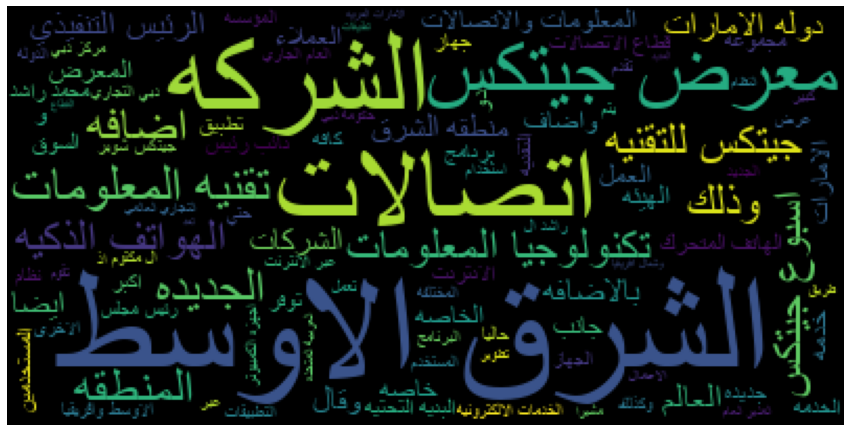

In [145]:
Tech = concatenate(data, "Tech")
generateWordCloud(Tech,"Tech")

Sports label
-----

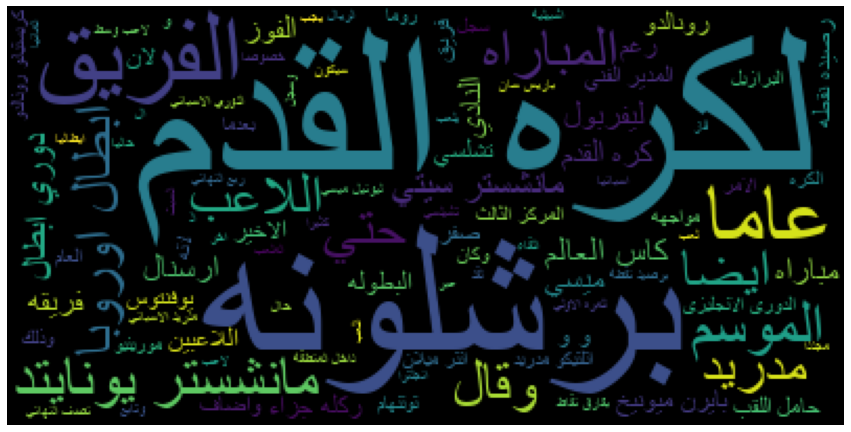

In [146]:
Sports = concatenate(data, "Sports")
generateWordCloud(Sports, "Sports")

Medical label
------

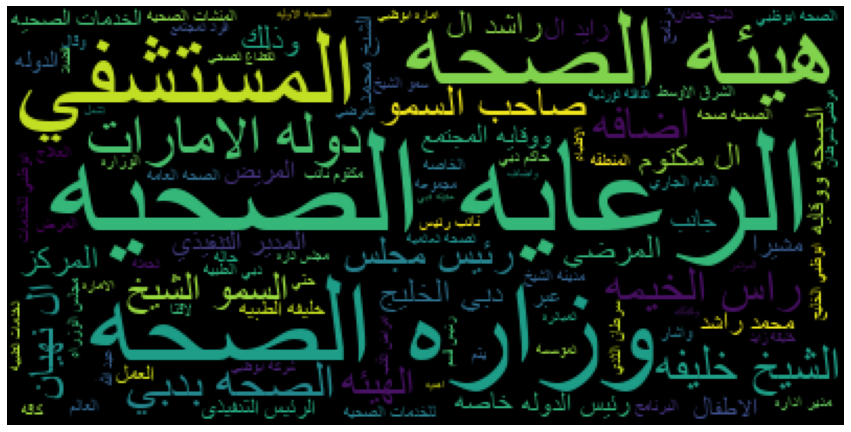

In [147]:
Medical = concatenate(data, "Medical")
generateWordCloud(Medical, "Medical")

Politics label
------

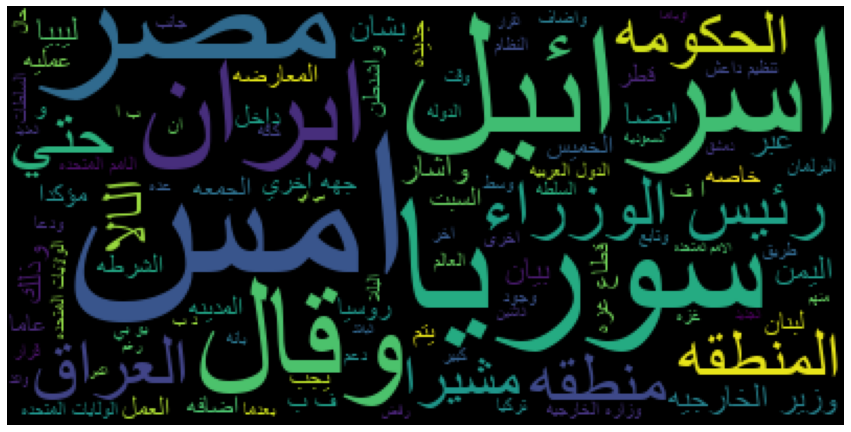

In [148]:
Politics = concatenate(data, "Politics")
generateWordCloud(Politics, "Politics")

Finance label
------

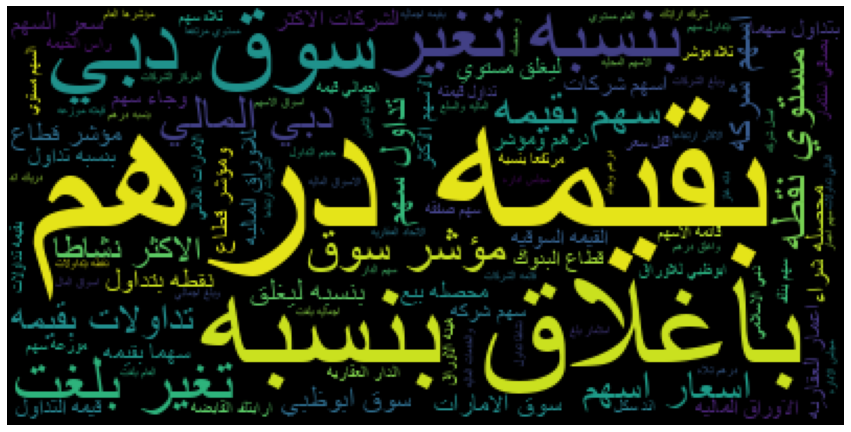

In [172]:
Finance = concatenate(data, "Finance")
generateWordCloud(Finance, "Finance")

Culture label
----------

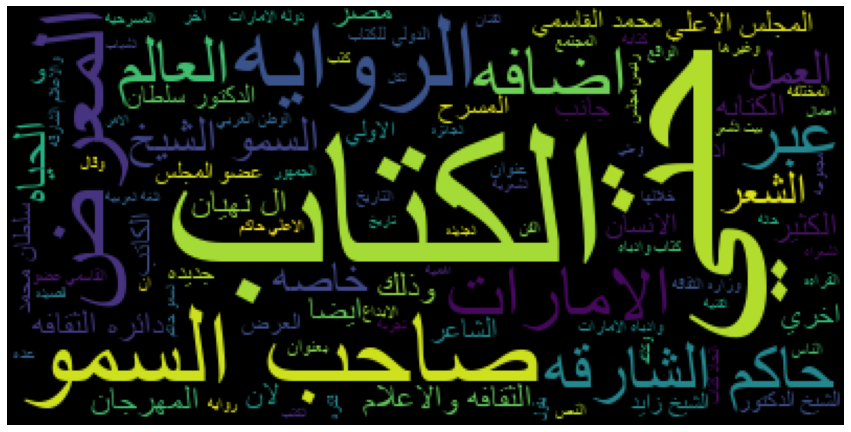

In [188]:
Culture = concatenate(data, "Culture")
generateWordCloud(Culture, "Culture")

8-Apply Stemming
---------

In [189]:
import nltk
from nltk.stem.isri import ISRIStemmer
st = ISRIStemmer()

In [190]:
def stemming(text):
    return " ".join([st.stem(word) for word in str(text).split()])

In [191]:
data['text'] = data['text'].apply(lambda x: stemming(x))

In [192]:
data["text"][136]

'اندراجيت سبهاروال عضو ندب لشر سيمترونيكس هند تخصص صنع هتف ذكه جهز كمبيوتر لوح شرك تبع كمبيوتر لوح شهر سوق امر حصه عده صدر سوق اخر طقه اضف سبهاروال صرح همش جيتكس شوبر خرف بيع شرك طقه ككل شهر تصل جهز شير شرك تحذ حصه سوق جهز خفض توسط سعر تصل وعل سيمترونيكس صنف ثلث قئم كبر شرك صنع جهز كمبيوتر لوح علم طلق كمبيوتر اكس باد ريدم كمبيوتر لوح زود علج ربع نوه علي سرع بتق جيل ثلث نقل بين سرع علي عضو ندب لشر سيمترونيكس تضم اكس باد ريدم حدث نتج شرك سيمترونيكس جمع مزا رئع تقن تقدم قدم ادء دينام علج ربع نوه تصل سرع غيغاهيرتز عمل نظم شغل جيل تمز جهز فئق نحف عمل نصه درويد برسوماته تقدم علي وضح ششه قاس بوص تبع وصل فئه كمبيوتر لوح طرح هلك سعر عقل دفع ؤشر طلب سلع استهلاكيه سوق نشئ كسق شرق وسط شمل فرق اشر طقه شرق وسط شمل فرق تعد سوق همه لشر سيمترونيكس وصل شرك نتج اكس باد ريدم عمل عزز نجا حلل تلب حيج خدم جهز كمبيوتر لوح'

In [193]:
data["text"][2]

'عقد ندي سسك وسكو روس هجم دول يجر حمد وسي لمد خمس عوم ندي نلو هولند حسب اعل وخض وسي عما برا نخب يجر سجل هدف وحد نضم عسكر سسك وسكو نجع كامبوامور اسب سعد فرق واج درد اسب دور دور بطل ورب لكر قدم وقل وسي انا سعد نقل منح سسك فرص لعب ورب لعب ميز ولم يتم كشف قيم صفق شبك وبر سبر جنب فرق كشف لعب كلف ندي روس لاي'

Let's visualize the data after stemming
------

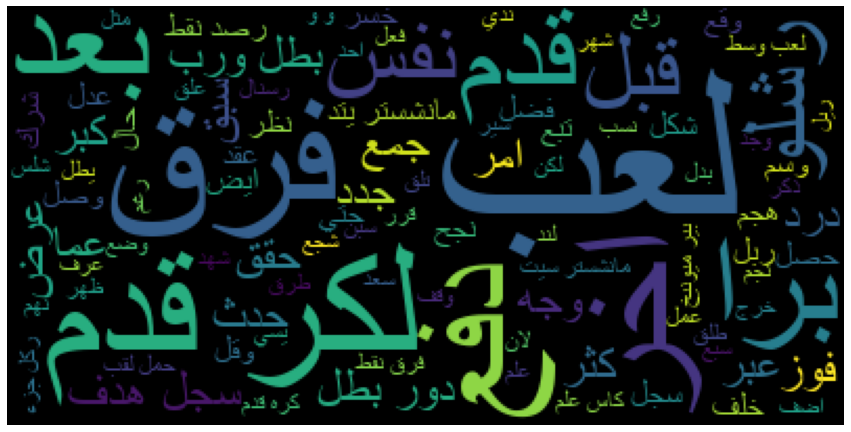

In [194]:
Sports = concatenate(data, "Sports")
generateWordCloud(Sports, "SportsAfterStemming")

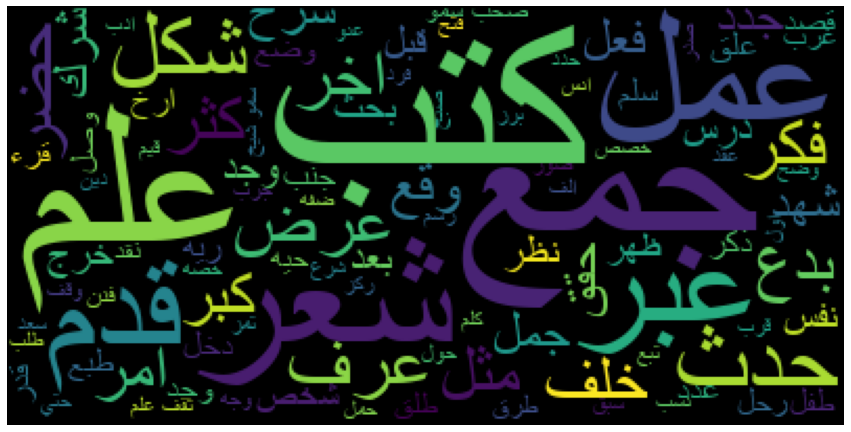

In [195]:
Culture = concatenate(data, "Culture")
generateWordCloud(Culture, "CultureAfterStemming")